![alt text](img.jpeg)

## Instructions

1.	Load the dataset into a data frame using Python.

2.	Clean the data as needed.

3.	Plot a line chart to show the average temperature fluctuations in Tunisia and Cameroon. Interpret the results.

4.	Zoom in to only include data between 1980 and 2005, try to customize the axes labels.

5.	Create Histograms to show temperature distribution in Senegal between [1980,2000] and [2000,2023] (in the same figure). Describe the obtained results.

6.	Select the best chart to show the Average temperature per country.

7.	Make your own questions about the dataset and try to answer them using the appropriate visuals.
 
Note: Feel free to choose the visualization library (e.g., Matplotlib, Seaborn, Plotly) that best suits your style and the requirements of the tasks listed below.

In [37]:
import pandas as pd

# Q1 : Load the dataset into a data frame using Python

In [38]:
data=pd.read_csv('Africa_climate_change.csv')

data

,DATE,PRCP,TAVG,TMAX,TMIN,COUNTRY
0,19800101 000000,NaN,54.0,61.0,43.0,Tunisia
1,19800101 000000,NaN,49.0,55.0,41.0,Tunisia
2,19800101 000000,0.0,72.0,86.0,59.0,Cameroon
3,19800101 000000,NaN,50.0,55.0,43.0,Tunisia
4,19800101 000000,NaN,75.0,91.0,NaN,Cameroon
...,...,...,...,...,...,...
464810,20230823 000000,NaN,85.0,89.0,NaN,Senegal
464811,20230823 000000,NaN,80.0,90.0,72.0,Egypt
464812,20230823 000000,NaN,87.0,NaN,73.0,Egypt
464813,20230823 000000,0.0,82.0,94.0,NaN,Senegal


# Q2 : Clean the data as needed

In [39]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 464815 entries, 0 to 464814
Data columns (total 6 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   DATE     464815 non-null  object 
 1   PRCP     177575 non-null  float64
 2   TAVG     458439 non-null  float64
 3   TMAX     363901 non-null  float64
 4   TMIN     332757 non-null  float64
 5   COUNTRY  464815 non-null  object 
dtypes: float64(4), object(2)
memory usage: 21.3+ MB


In [40]:
data.describe()

,PRCP,TAVG,TMAX,TMIN
count,177575.000000,458439.000000,363901.000000,332757.000000
mean,0.120941,77.029838,88.713969,65.548262
std,0.486208,11.523634,13.042631,11.536547
min,0.000000,-49.000000,41.000000,12.000000
25%,0.000000,70.000000,81.000000,58.000000
50%,0.000000,80.000000,90.000000,68.000000
75%,0.010000,85.000000,99.000000,74.000000
max,19.690000,110.000000,123.000000,97.000000


In [41]:
data.isnull().sum()

DATE            0
PRCP       287240
TAVG         6376
TMAX       100914
TMIN       132058
COUNTRY         0
dtype: int64

### *as we are only analyzing and exploring data*

### *I prefere to not drop or change anything on our dataset*

but in case we were studying the data beyond that, i would proceed as so :

* for the missing values can not use imputation technique or anything as each line is unique we can not randomly assign values

* we could drop the column PRCP (precipiration) with out droping lines as we will not use the variable as it is not directly related to temperature itself

* for the rest variables with missing values, we can check their correlation and then decide if we might drop rows or columns

In [42]:
# converting date column type

data['DATE']=pd.to_datetime(data['DATE'])
data['Year']=data["DATE"].dt.year

data

,DATE,PRCP,TAVG,TMAX,TMIN,COUNTRY,Year
0,1980-01-01,NaN,54.0,61.0,43.0,Tunisia,1980
1,1980-01-01,NaN,49.0,55.0,41.0,Tunisia,1980
2,1980-01-01,0.0,72.0,86.0,59.0,Cameroon,1980
3,1980-01-01,NaN,50.0,55.0,43.0,Tunisia,1980
4,1980-01-01,NaN,75.0,91.0,NaN,Cameroon,1980
...,...,...,...,...,...,...,...
464810,2023-08-23,NaN,85.0,89.0,NaN,Senegal,2023
464811,2023-08-23,NaN,80.0,90.0,72.0,Egypt,2023
464812,2023-08-23,NaN,87.0,NaN,73.0,Egypt,2023
464813,2023-08-23,0.0,82.0,94.0,NaN,Senegal,2023


## Q3 : Plot a line chart to show the average temperature fluctuations in Tunisia and Cameroon


In [43]:
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns

In [44]:
d_line=data.query('COUNTRY in ["Tunisia","Cameroon"]')

d_line

,DATE,PRCP,TAVG,TMAX,TMIN,COUNTRY,Year
0,1980-01-01,NaN,54.0,61.0,43.0,Tunisia,1980
1,1980-01-01,NaN,49.0,55.0,41.0,Tunisia,1980
2,1980-01-01,0.00,72.0,86.0,59.0,Cameroon,1980
3,1980-01-01,NaN,50.0,55.0,43.0,Tunisia,1980
4,1980-01-01,NaN,75.0,91.0,NaN,Cameroon,1980
...,...,...,...,...,...,...,...
464796,2023-08-23,0.00,85.0,NaN,NaN,Tunisia,2023
464799,2023-08-23,0.00,90.0,102.0,80.0,Tunisia,2023
464804,2023-08-23,0.13,84.0,NaN,70.0,Tunisia,2023
464809,2023-08-23,0.00,85.0,96.0,77.0,Tunisia,2023


In [45]:
fig=px.line(d_line,x='Year',y='TAVG',color='COUNTRY',labels={'Year': 'AVG tempeture over years', 'TAVG': 'average of temperature'},title='Average temperature fluctuations in Tunisia and Cameroon',)
fig

# Interpret the results

the plot shows us that in both countries the avg temperature is proportionally high

tunisia has recorded -49 as lowest avg temp in the 2023, and recorded the highest avg temp in few years for example 1999,2001

where cameroon has recorded the highest avg temp 108 in 2016 and and lowest avg temp 50 in 1980

however cameroon, is still the most one having the highest avg temperature comparing to tunisia

# Q4 : Zoom in to only include data between 1980 and 2005, try to customize the axes labels

In [46]:
fig_z=px.line(d_line,x='Year',y='TAVG',color='COUNTRY',labels={'Year': 'AVG tempeture over years', 'TAVG': 'average of temperature'},title='Average temperature fluctuations in Tunisia and Cameroon',range_x=[1980,2005])
fig_z

# Q5 : Create Histograms to show temperature distribution in Senegal between [1980,2000] and [2000,2023] (in the same figure)


In [47]:
d_histo=data.query('COUNTRY=="Senegal"')

d_histo

,DATE,PRCP,TAVG,TMAX,TMIN,COUNTRY,Year
6,1980-01-01,0.00,76.0,97.0,59.0,Senegal,1980
7,1980-01-01,0.00,74.0,95.0,59.0,Senegal,1980
8,1980-01-01,0.00,78.0,93.0,63.0,Senegal,1980
9,1980-01-01,0.00,76.0,91.0,59.0,Senegal,1980
11,1980-01-01,NaN,84.0,99.0,NaN,Senegal,1980
...,...,...,...,...,...,...,...
464803,2023-08-23,1.22,83.0,90.0,76.0,Senegal,2023
464807,2023-08-23,NaN,87.0,99.0,NaN,Senegal,2023
464808,2023-08-23,0.16,82.0,NaN,NaN,Senegal,2023
464810,2023-08-23,NaN,85.0,89.0,NaN,Senegal,2023


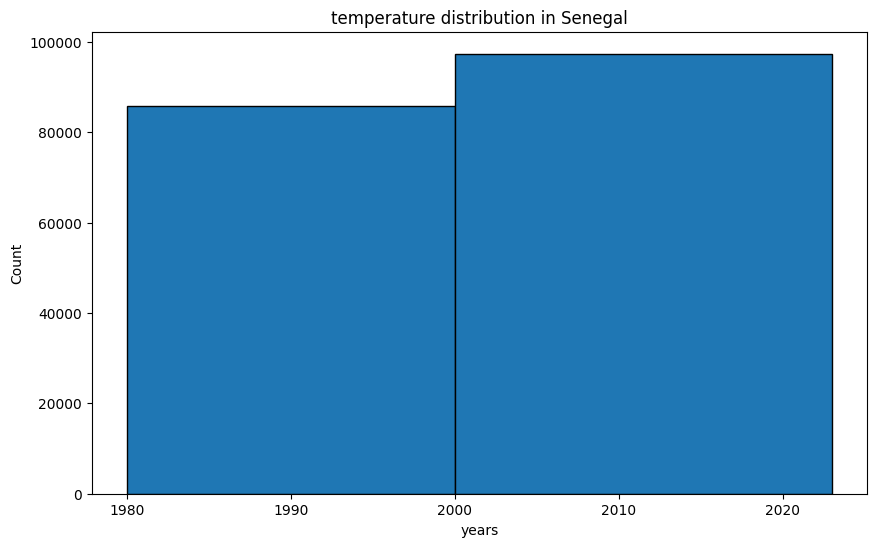

In [48]:
plt.figure(figsize=(10,6))
plt.title('temperature distribution in Senegal')
plt.hist(x=d_histo['Year'],bins=[1980,2000,2023],edgecolor='black')
plt.xlabel('years')
plt.ylabel('Count')
plt.show()

# Describe the obtained results

there is a slight difference between [1980,2000] and [2000,2023] in terms of observation count

which can be interpreted that is way: in [2000,2023] has known more temperature fluctuation than [1980,2000]

# Q6 : Select the best chart to show the Average temperature per country

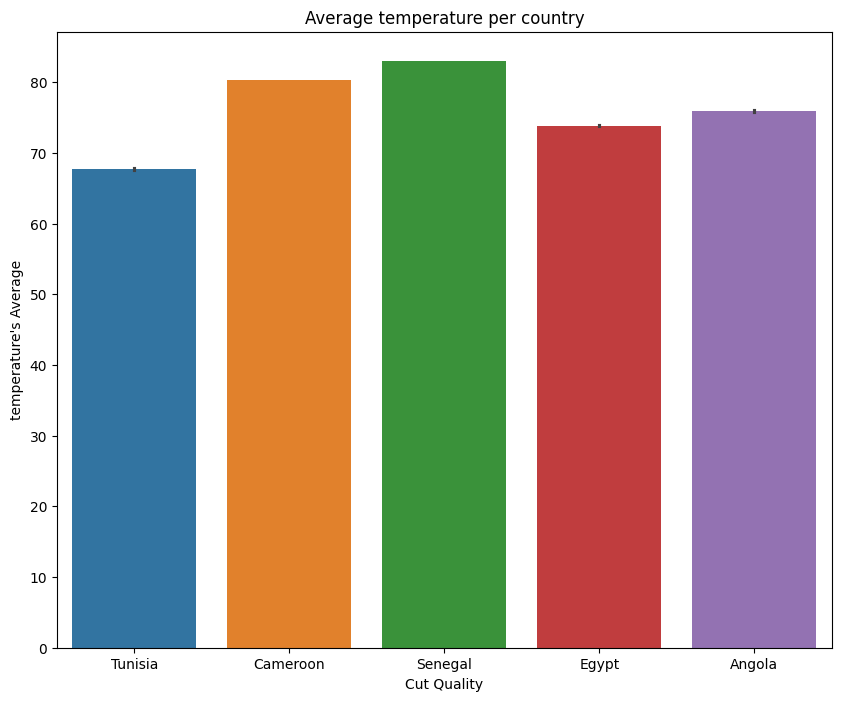

In [49]:
plt.figure(figsize=(10,8))
plt.title('Average temperature per country')
plt.xlabel('Cut Quality')
plt.ylabel("temperature's Average")  
sns.barplot(data,x='COUNTRY',y='TAVG',hue='COUNTRY')
plt.show()

# Q7 : Make your own questions about the dataset and try to answer them using the appropriate visuals

## *1- display column's distribution*

In [50]:
from plotly.subplots import make_subplots

In [51]:
cols=4

size_rows=(cols//2)  + (1 if cols%2 > 0 else 0)

size_rows

2

In [52]:
fig=make_subplots(rows=size_rows,cols=2,subplot_titles=data.columns[1:-2])

for index,column in enumerate(data.columns[1:-2]) :
    row_plot=index//2+1
    col_plot=index%2+1

    fig.add_trace(
        go.Histogram(x=data[column],name=column),
        row=row_plot,col=col_plot
        )


fig.update_layout(height=300 *size_rows,title='distribution of temperatures')

fig.show()

### only TMAX & TMIN columns seem to be near a normal distrubution

## *2- check outliers*

In [53]:
cols_b=4

size_rows_b=(cols_b//2)  + (1 if cols_b%2 > 0 else 0)

fig_box=make_subplots(rows=size_rows_b,cols=2,subplot_titles=data.columns[1:-2])

for index,column in enumerate(data.columns[1:-2]) :
    row_plot_b=index//2+1
    col_plot_b=index%2+1

    fig_box.add_trace(
        go.Box(x=data[column],name=column,boxmean=True),
        row=row_plot_b,col=col_plot_b
        )

fig_box.update_layout(height=300 *size_rows_b,title='outliers detection')

fig_box.show()

## PRCP has more outliers as it contains more missing values

## *3- checking correlation table*

In [54]:
temp_corr=data.corr(numeric_only=True)

temp_corr

,PRCP,TAVG,TMAX,TMIN,Year
PRCP,1.000000,0.058191,0.012396,0.122140,0.065755
TAVG,0.058191,1.000000,0.943893,0.913932,0.042397
TMAX,0.012396,0.943893,1.000000,0.790032,0.026611
TMIN,0.122140,0.913932,0.790032,1.000000,0.043914
Year,0.065755,0.042397,0.026611,0.043914,1.000000


In [55]:
fig_corr=px.imshow(temp_corr,text_auto=True,aspect=True)

fig_corr.show()

## the only correlations we have, are between TAVG, TMAX & TMIN